In [1]:
import os
import matplotlib.pyplot as plt
import librosa, librosa.display
import IPython.display as ipd
import numpy as np
import wave
plt.rcParams['figure.figsize']=[20,4]
plt.rcParams.update({'font.size':20})

In [2]:
sound_file = "speaking-the-proper-use-of-pitch-for-your-speaking-voice.wav"

In [3]:
ipd.Audio(sound_file)

In [4]:
def SplitAudio(start,end,name,ogname):
    # times between which to extract the wave from
    start = start# seconds
    end = end # seconds 
    n=name+'.wav'

    # file to extract the snippet from
    with wave.open(ogname, "rb") as infile:
        # get file data
        nchannels = infile.getnchannels()
        sampwidth = infile.getsampwidth()
        framerate = infile.getframerate()
        # set position in wave to start of segment
        infile.setpos(int(start * framerate))
        # extract data
        data = infile.readframes(int((end - start) * framerate))

    # write the extracted data to a new file
    with wave.open(n, 'w') as outfile:
        outfile.setnchannels(nchannels)
        outfile.setsampwidth(sampwidth)
        outfile.setframerate(framerate)
        outfile.setnframes(int(len(data) / sampwidth))
        outfile.writeframes(data)

In [53]:
# SplitAudio(0.00,8.00,'audio1',sound_file)
# a1='audio1.wav'
a1='violin-C4.wav'

In [54]:
# SplitAudio(0.00,1.50,'sa1',a)

In [55]:
# a1='sa1.wav'

In [56]:
ipd.Audio(a1)

In [57]:
voice1, sr1 = librosa.load(a1)

In [58]:
print("Duration of Audio : ",librosa.get_duration(voice1,sr1),"sec")

Duration of Audio :  3.492063492063492 sec


Text(0.5, 1.0, 'Time Domain')

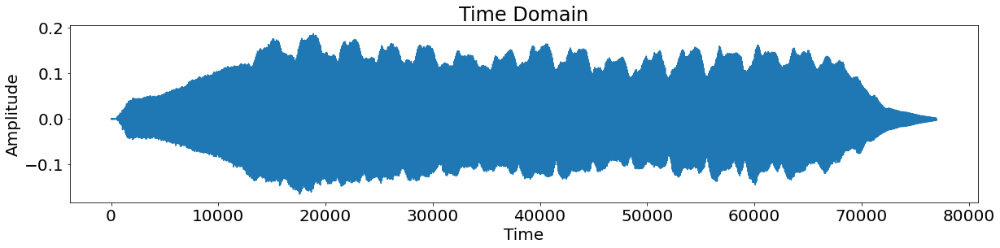

In [59]:
plt.plot(voice1)
plt.xlabel('Time') 
plt.ylabel('Amplitude')
plt.title('Time Domain')

In [60]:
def limitFreq(freq,size):
    for i,j in enumerate(freq):
        if j>size:
            return i
            break

77000
77000
17461
1196.4244457986842


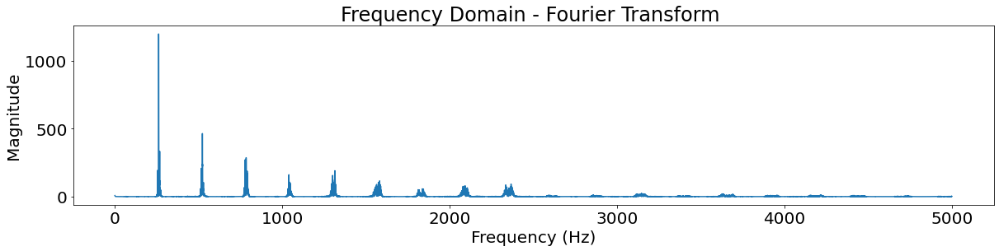

In [61]:
 
n=len(voice1)
print(n)
X = np.fft.fft(voice1)
print(len(X))
X_mag1 = np.absolute(X)
f1 = np.linspace(0, sr1, len(X_mag1))
f_bins1=limitFreq(f1,5000)
print(f_bins1)   
plt.plot(f1[1:f_bins1], X_mag1[1:f_bins1])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ')
print(max(X_mag1[1:f_bins1])) 
plt.show()   


In [62]:

def remove_till_limit(Xaxis,limit,maxBins):
    newX=[]
    for i in Xaxis[:maxBins]:
        if i<limit:
            newX.append(0)
        else:
            newX.append(i)
    return newX
        

In [75]:
newX_mag1=remove_till_limit(X_mag1,500,f_bins1)

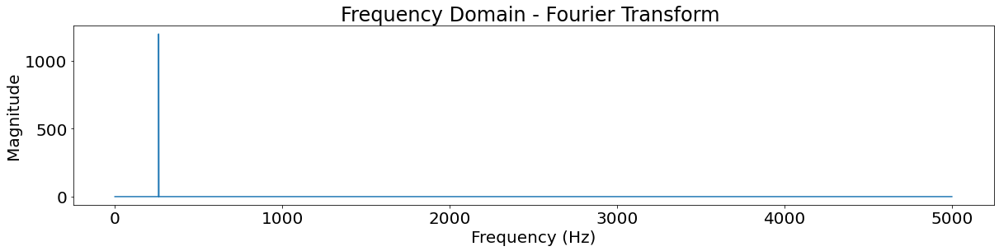

In [76]:
plt.plot(f1[1:f_bins1], newX_mag1[1:f_bins1])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ') 
plt.show()    

In [77]:
def getFundamental(Xaxis,bins):
    for i,j in enumerate(Xaxis[1:bins]):
        if j>0:
            return i

In [78]:
print(f"Fundamental Frequency is {round(f1[getFundamental(newX_mag1,f_bins1)])} Hz") 

Fundamental Frequency is 261 Hz


In [19]:
# 2nd
SplitAudio(9.00,12.00,'audio2',sound_file)
a2='audio2.wav'

In [20]:
ipd.Audio(a2)

Text(0.5, 1.0, 'Time Domain')

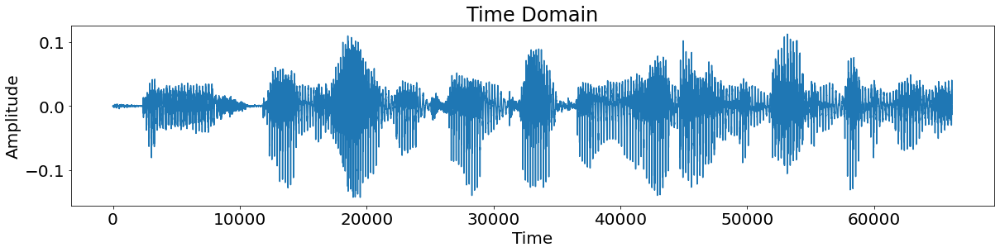

In [21]:
voice2, sr2 = librosa.load(a2)
plt.plot(voice2)
plt.xlabel('Time') 
plt.ylabel('Amplitude')
plt.title('Time Domain')

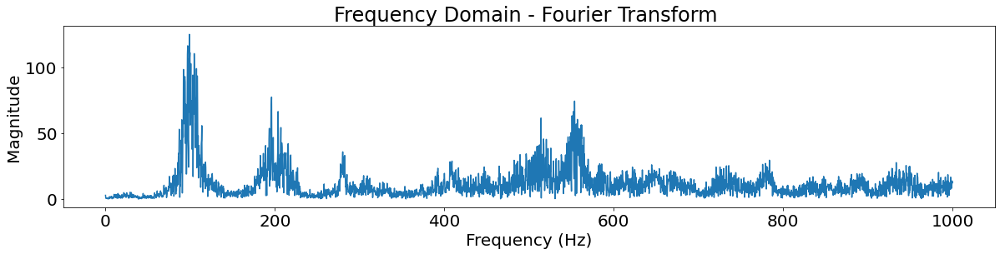

125.04745570189169


In [22]:
X2 = np.fft.fft(voice2) 
X_mag2 = np.absolute(X2)
f2 = np.linspace(0, sr2, len(X_mag2))
f_bins2=limitFreq(f2,1000)  
plt.plot(f2[:f_bins2], X_mag2[:f_bins2])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ')
# x,y=plt.xlim() 
plt.show()   
print(max(X_mag2[:f_bins2])) 

In [23]:
newX_mag2=remove_till_limit(X_mag2,60,f_bins2)

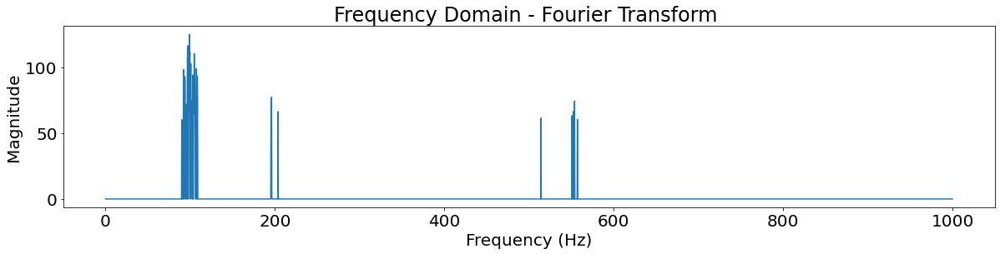

In [24]:
plt.plot(f2[:f_bins2], newX_mag2[:f_bins2])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ') 
plt.show() 

In [25]:
print(f"Fundamental Frequency is {round(f2[getFundamental(newX_mag2,f_bins2)])} Hz") 

Fundamental Frequency is 90 Hz


In [26]:
# 3rd
SplitAudio(12.50,16.50,'audio3',sound_file)
a3='audio3.wav'
ipd.Audio(a3)

length is 88200  & Sampling rate is 22050


Text(0.5, 1.0, 'Time Domain')

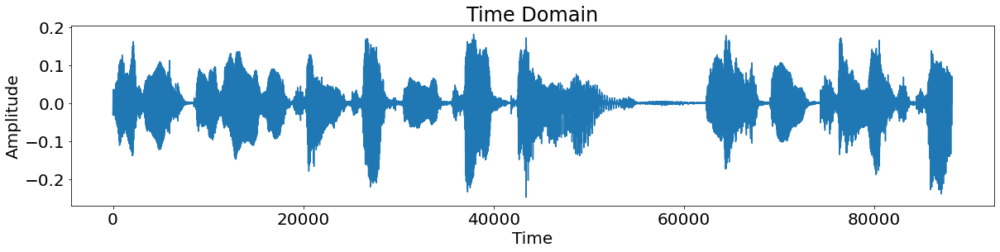

In [27]:
voice3, sr3 = librosa.load(a3)
print("length is",len(voice3)," & Sampling rate is",sr3)
plt.plot(voice3)
plt.xlabel('Time') 
plt.ylabel('Amplitude')
plt.title('Time Domain')

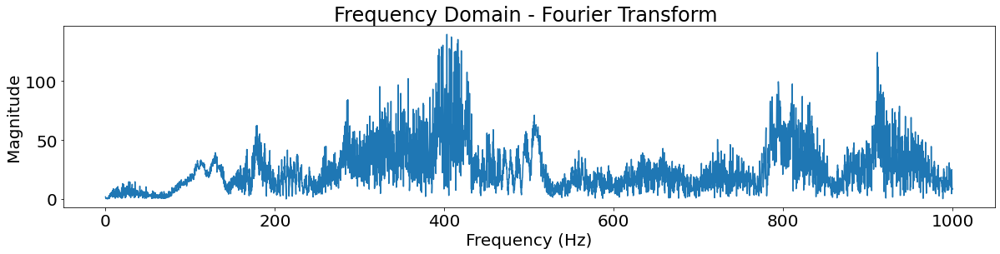

125.04745570189169


In [28]:
X3 = np.fft.fft(voice3) 
X_mag3 = np.absolute(X3)
f3 = np.linspace(0, sr3, len(X_mag3))
f_bins3=limitFreq(f3,1000)  
plt.plot(f3[:f_bins3], X_mag3[:f_bins3])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ')
# x,y=plt.xlim() 
plt.show()   
print(max(X_mag2[:f_bins3])) 

In [29]:
newX_mag3=remove_till_limit(X_mag3,100,f_bins3)

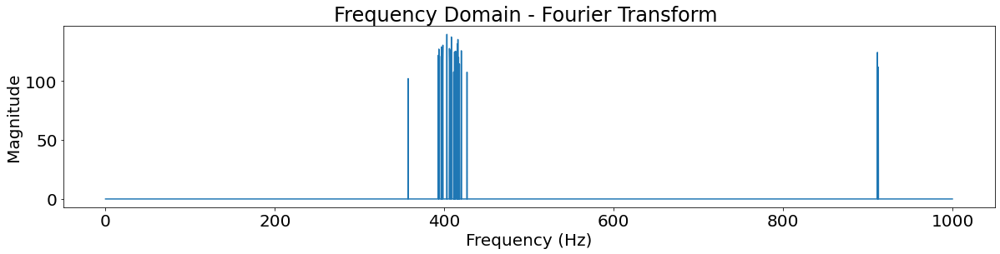

In [30]:
plt.plot(f3[:f_bins3], newX_mag3[:f_bins3])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ') 
plt.show() 

In [31]:
print(f"Fundamental Frequency is {round(f3[getFundamental(newX_mag3,f_bins3)])} Hz") 

Fundamental Frequency is 357 Hz


# Random

In [32]:
import crepe

In [33]:
import crepe
from scipy.io import wavfile

In [34]:
# sr, audio = wavfile.read('audio1.wav')
# time, frequency, confidence, activation = crepe.predict(audio, sr, viterbi=True)

In [35]:
import pandas as pd

In [88]:
df=pd.read_csv('violin-C6.f0.csv')

In [89]:
frq=df[df.confidence>0.90]

In [90]:
frq.frequency.mean()

1043.7630606060604

# Random 2

In [79]:
a='violin-C6.wav'

In [80]:
voice1, sr1 = librosa.load(a)

Text(0.5, 1.0, 'Power Spectrum')

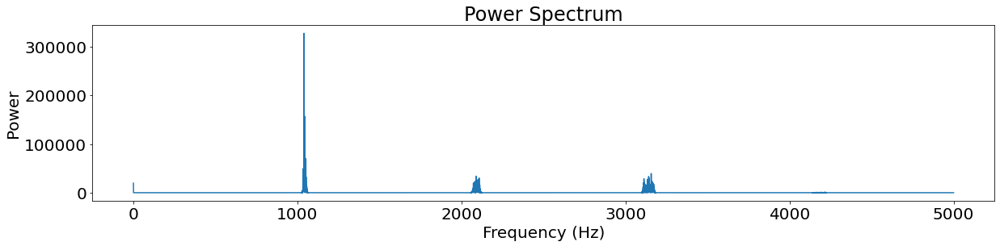

In [81]:
X = np.fft.fft(voice1)
X_mag = np.absolute(X)
power_spectrum = np.square(X_mag)
f = np.linspace(0, sr1, len(power_spectrum))
f_bins1=limitFreq(f,5000)
plt.plot(f[:f_bins1], power_spectrum[:f_bins1])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.title('Power Spectrum')

In [85]:
newX_mag=remove_till_limit(power_spectrum,200000,f_bins1)

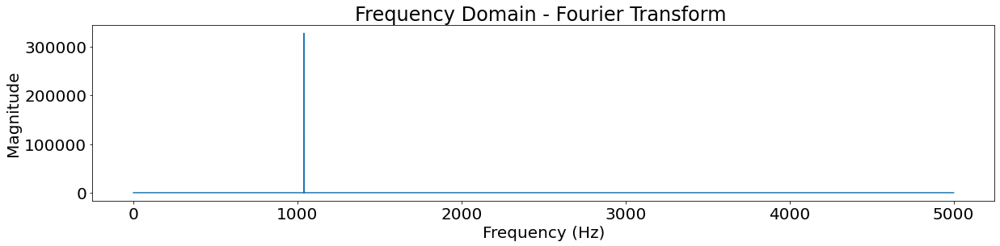

In [86]:
plt.plot(f[:f_bins1], newX_mag[:f_bins1])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Frequency Domain - Fourier Transform ') 
plt.show() 

In [87]:
print(f"Fundamental Frequency is {round(f[getFundamental(newX_mag,f_bins1)])} Hz") 

Fundamental Frequency is 1039 Hz
